In [17]:
%load_ext autoreload
%autoreload 2

from pathlib import Path

from hloc import extract_features, match_features, reconstruction, visualization

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Setup
We will run SfM reconstruction from scratch on a set of images. We choose CMU seasons. The pairs are generated by NetVLAD.

In [18]:
dataset = Path('/home/cloudlet/datasets/argoverse-tracking/sample/test_1017_2')
images = dataset / 'db_query/'

pairs = Path('pairs/argo_1017_2/')
sfm_pairs = pairs / 'pairs60_argo_db.txt'  # top 20 retrieved by NetVLAD
loc_pairs = pairs / 'pairs60_argo_query.txt'  # top 20 retrieved by NetVLAD

outputs = Path('outputs/argo_sample_2/')
# sfm_pairs = outputs / 'pairs-exhaustive.txt'  # exhaustive matching
sfm_dir = outputs / 'sfm_superpoint+superglue+netvlad'

feature_conf = extract_features.confs['superpoint_aachen']
matcher_conf = match_features.confs['superglue']

features = feature_conf['output']
feature_file = f"{features}.h5"
match_file = f"{features}_{matcher_conf['output']}_{sfm_pairs.stem}.h5"
match_file_query = f"{features}_{matcher_conf['output']}_{loc_pairs.stem}.h5"

## Extract local features

In [19]:
extract_features.main(feature_conf, images, outputs)

[10/17/2020 12:33:11 INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 4096, 'name': 'superpoint', 'nms_radius': 3},
 'output': 'feats-superpoint-n4096-r1024',
 'preprocessing': {'grayscale': True, 'resize_max': 1024}}
Loaded SuperPoint model
[10/17/2020 12:33:11 INFO] Found 1333 images in root /home/cloudlet/datasets/argoverse-tracking/sample/test_1017_2/db_query.


100%|██████████| 1333/1333 [00:23<00:00, 57.64it/s]

[10/17/2020 12:33:34 INFO] Finished exporting features.


## Matching using NetVLAD pairs (Top60)

In [20]:
match_features.main(matcher_conf, sfm_pairs, features, outputs)

[10/17/2020 12:33:34 INFO] Matching local features with configuration:
{'model': {'name': 'superglue',
           'sinkhorn_iterations': 50,
           'weights': 'outdoor'},
 'output': 'matches-superglue'}


  0%|          | 0/47100 [00:00<?, ?it/s]

cuda
Loaded SuperGlue model ("outdoor" weights)


100%|██████████| 47100/47100 [34:22<00:00, 22.84it/s]  

[10/17/2020 13:07:57 INFO] Finished exporting matches.


## Match the query images
Do feature matching for the query images.

In [21]:
match_features.main(matcher_conf, loc_pairs, features, outputs)

[10/17/2020 13:07:57 INFO] Matching local features with configuration:
{'model': {'name': 'superglue',
           'sinkhorn_iterations': 50,
           'weights': 'outdoor'},
 'output': 'matches-superglue'}


  0%|          | 0/32880 [00:00<?, ?it/s]

cuda
Loaded SuperGlue model ("outdoor" weights)


100%|██████████| 32880/32880 [49:56<00:00, 10.97it/s] 

[10/17/2020 13:57:54 INFO] Finished exporting matches.


## SfM reconstruction
Run COLMAP on the features and matches.

In [22]:
images_db = dataset / 'db'
reconstruction.main(
    sfm_dir,
    images_db,
    sfm_pairs,
    outputs / feature_file,
    outputs / match_file)

[10/17/2020 13:57:54 INFO] Creating an empty database...
[10/17/2020 13:57:54 INFO] Importing images into the database...
[10/17/2020 13:58:07 INFO] Importing features into the database...


100%|██████████| 785/785 [00:00<00:00, 2301.50it/s]


[10/17/2020 13:58:08 INFO] Importing matches into the database...


100%|██████████| 47100/47100 [00:12<00:00, 3916.05it/s]


[10/17/2020 13:58:21 INFO] Performing geometric verification of the matches...
[10/17/2020 13:59:24 INFO] Running the 3D reconstruction...
[10/17/2020 13:59:24 INFO] colmap mapper --database_path outputs/argo_sample_2/sfm_superpoint+superglue+netvlad/database.db --image_path /home/cloudlet/datasets/argoverse-tracking/sample/test_1017_2/db --output_path outputs/argo_sample_2/sfm_superpoint+superglue+netvlad/models --Mapper.num_threads 32
[10/17/2020 14:58:20 INFO] Reconstructed 1 models.
[10/17/2020 14:58:20 INFO] Largest model is #0 with {largest_model_num_images} images.
[10/17/2020 14:58:20 INFO] Statistics:
{'mean_reproj_error': 1.29,
 'mean_track_length': 10.642031,
 'num_input_images': 785,
 'num_observations': 1170634,
 'num_observations_per_image': 1491.253503,
 'num_reg_images': 785,
 'num_sparse_points': 110001}


## Rescale the model based on the ground truth position of db images

In [29]:
import os
output_dir = '/home/cloudlet/work/Hierarchical-Localization/outputs/argo_sample_2/sfm_superpoint+superglue+netvlad/models/model_aligned/'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
cmd = 'colmap model_aligner \
    --input_path /home/cloudlet/work/Hierarchical-Localization/outputs/argo_sample_2/sfm_superpoint+superglue+netvlad/models/0/ \
    --output_path ' + output_dir + '\
    --ref_images_path /home/cloudlet/datasets/argoverse-tracking/sample/test_1017_2/db_location_1017_2.txt \
    --robust_alignment_max_error 0.5'
os.system(cmd)

0

## Visualization
We visualize some of the registered images, and color their keypoint by visibility, track length, or triangulated depth.

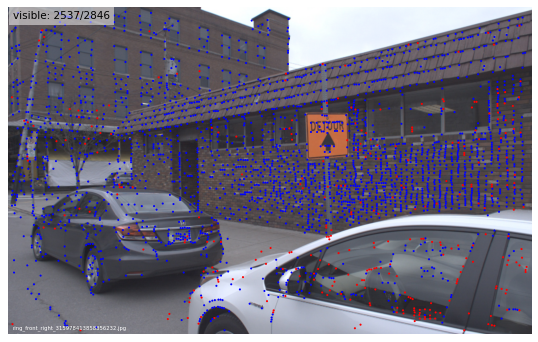

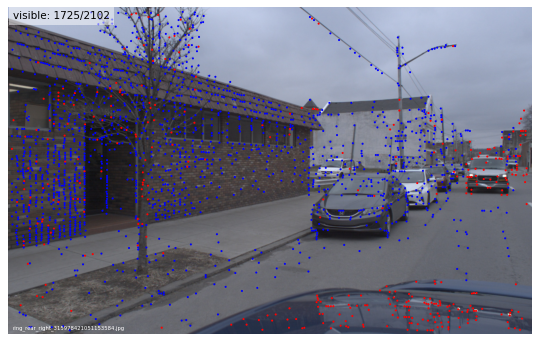

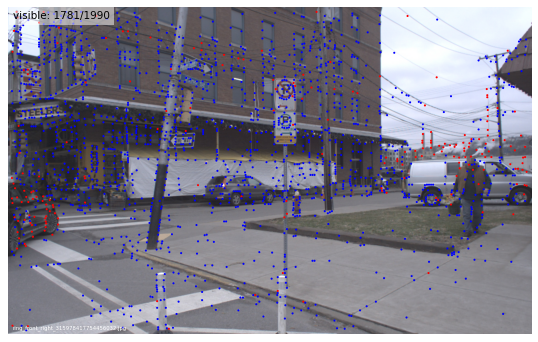

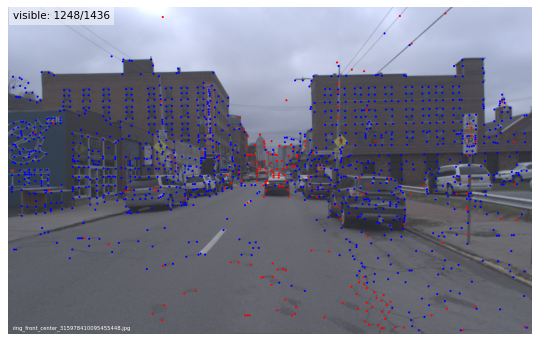

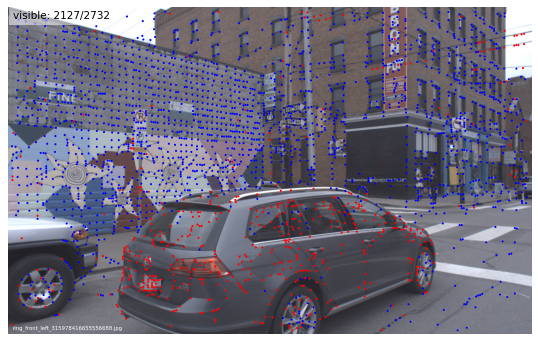

...

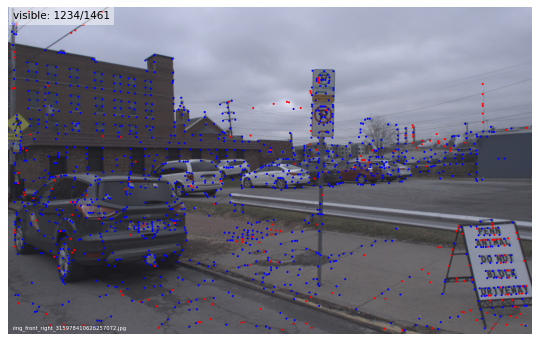

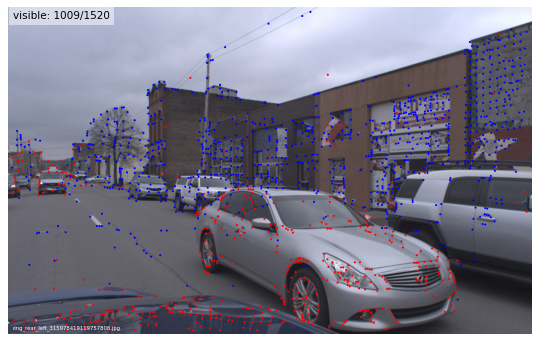

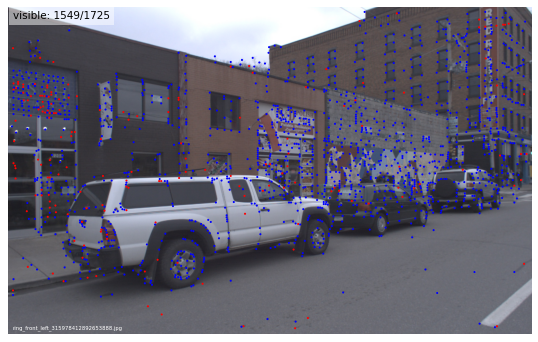

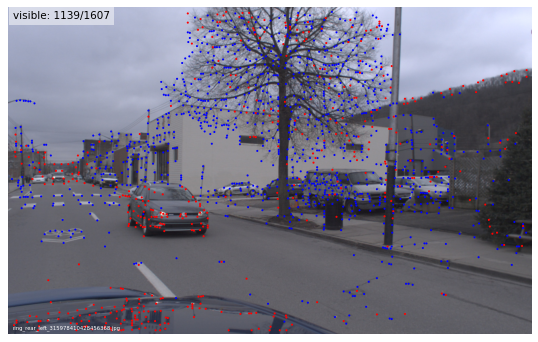

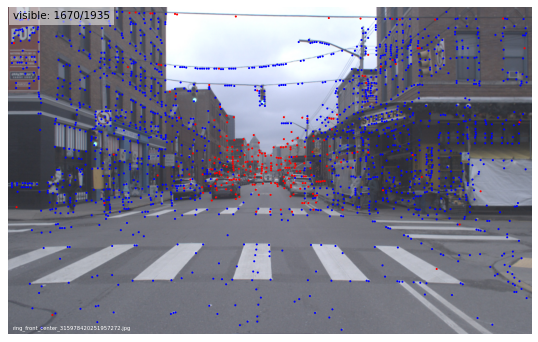

In [24]:
visualization.visualize_sfm_2d(sfm_dir / 'models/0', images, color_by='visibility', n=15)

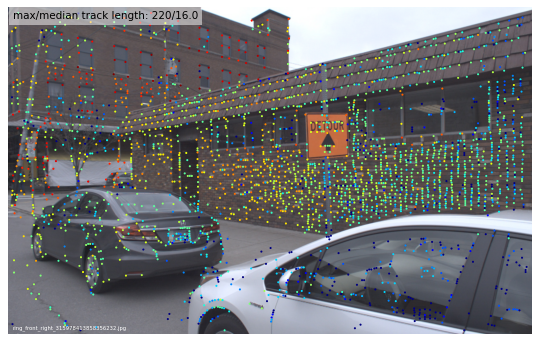

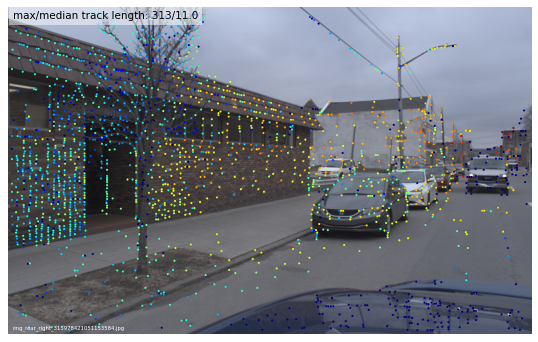

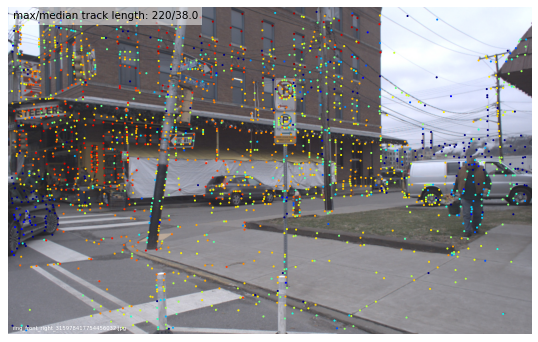

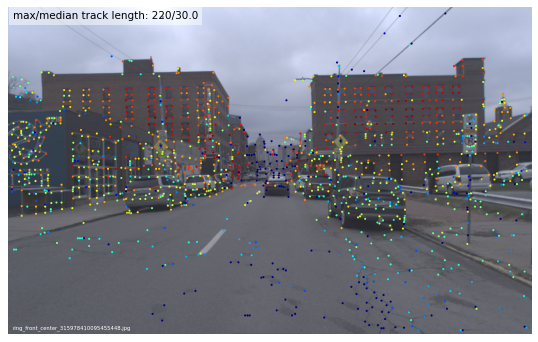

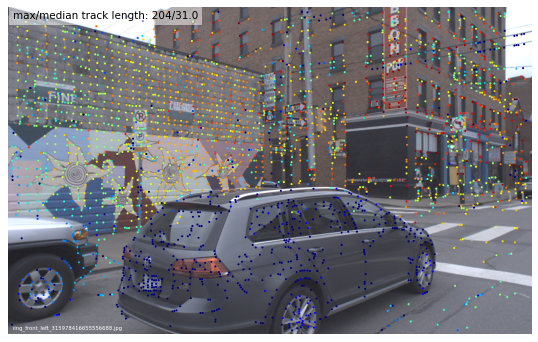

...

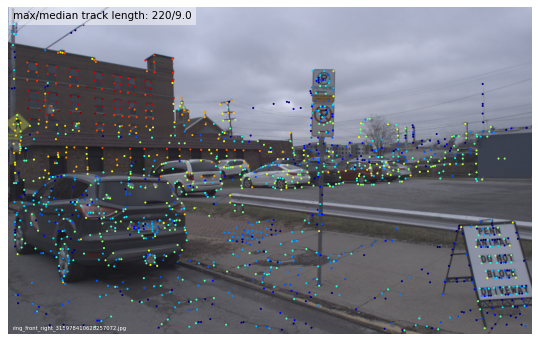

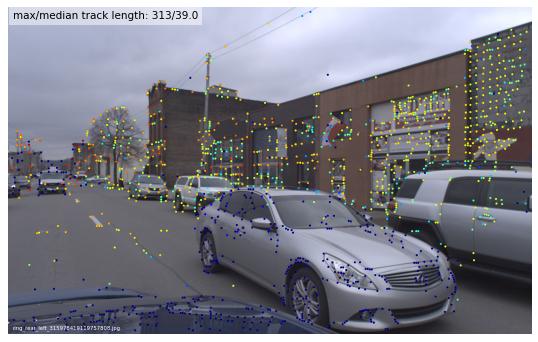

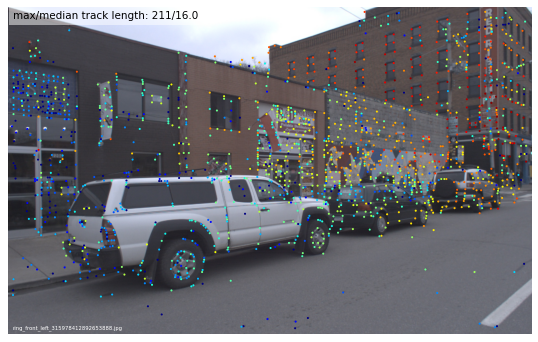

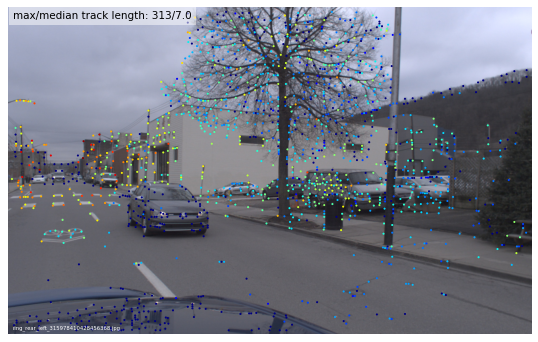

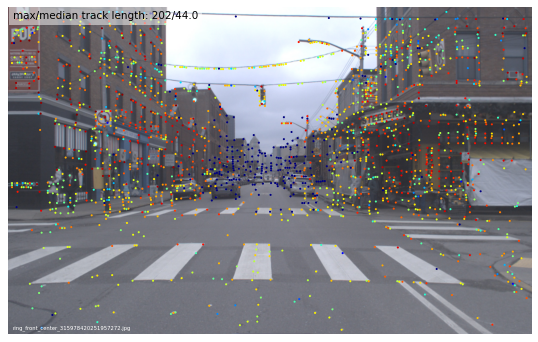

In [25]:
visualization.visualize_sfm_2d(sfm_dir / 'models/0', images, color_by='track_length', n=15)

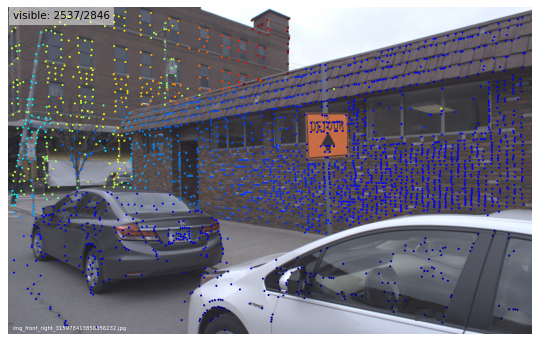

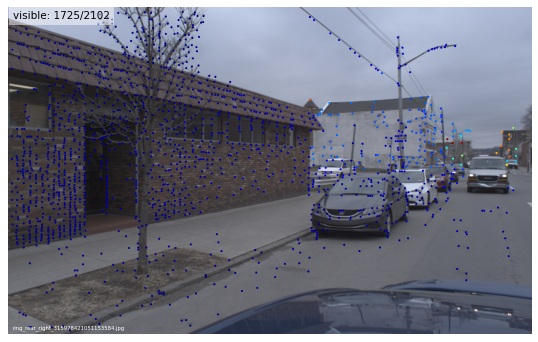

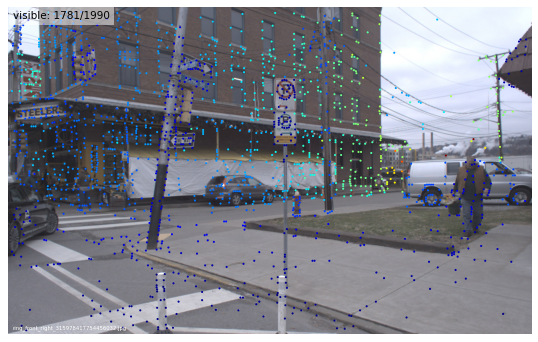

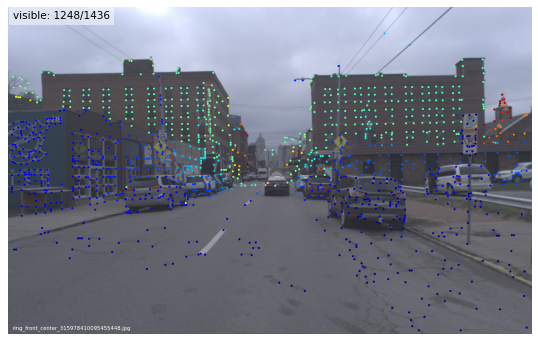

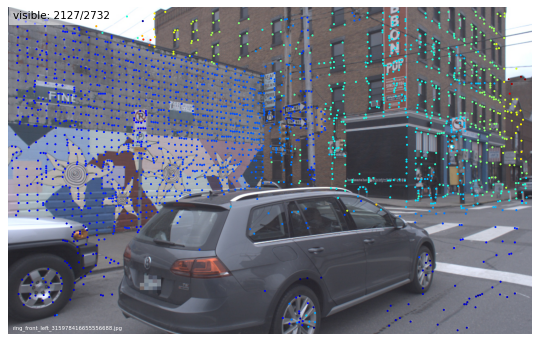

...

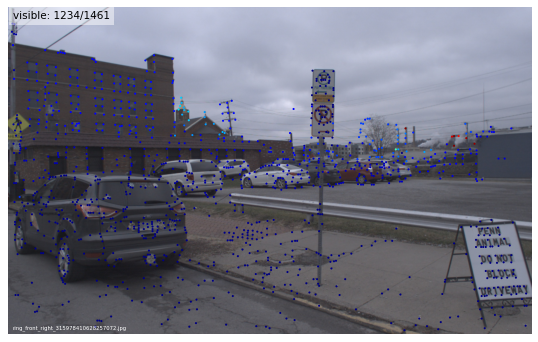

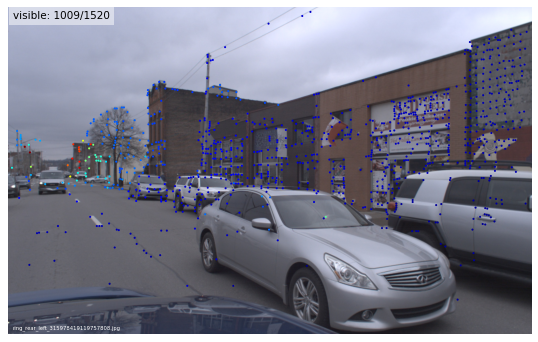

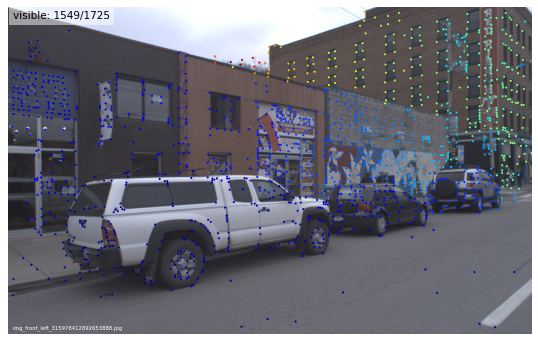

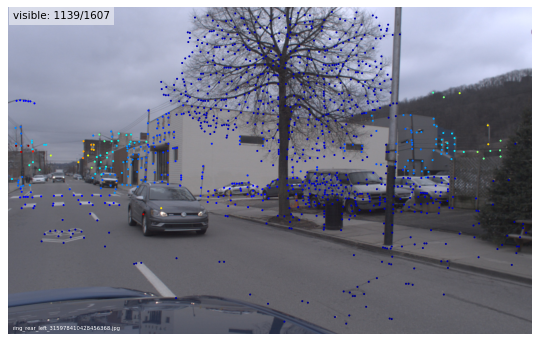

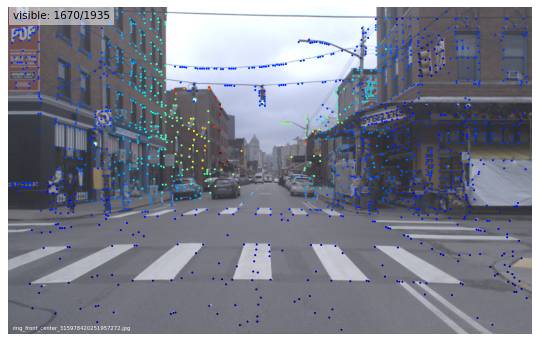

In [26]:
visualization.visualize_sfm_2d(sfm_dir / 'models/0', images, color_by='depth', n=15)

## Localize!
Perform hierarchical localization using the precomputed retrieval and matches.

In [30]:
from hloc import localize_sfm
# RING_IMG_WIDTH = 1920
# RING_IMG_HEIGHT = 1200
results = outputs / 'argo_hloc_superpoint+superglue_netvlad60.txt'  # the result file

localize_sfm.main(
    sfm_dir / 'models/model_aligned/',
    dataset / 'queries_with_intrinsics_1017_2.txt',
    loc_pairs,
    outputs / f"{feature_conf['output']}.h5",
    outputs / f"{feature_conf['output']}_{matcher_conf['output']}_{loc_pairs.stem}.h5",
    results,
    covisibility_clustering=False)  # not required with SuperPoint+SuperGlue

[10/17/2020 15:12:02 INFO] Importing 548 queries in queries_with_intrinsics_1017_2.txt
[10/17/2020 15:12:02 INFO] Reading 3D model...
785
[10/17/2020 15:12:04 INFO] Starting localization...


100%|██████████| 548/548 [02:25<00:00,  3.76it/s]

[10/17/2020 15:14:30 INFO] Localized 548 / 548 images.
[10/17/2020 15:14:30 INFO] Writing poses to outputs/argo_sample_2/argo_hloc_superpoint+superglue_netvlad60.txt...
[10/17/2020 15:14:30 INFO] Writing logs to outputs/argo_sample_2/argo_hloc_superpoint+superglue_netvlad60.txt_logs.pkl...


[10/17/2020 15:14:42 INFO] Done!


/home/cloudlet/work/Hierarchical-Localization/hloc/utils/viz.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  1, n, figsize=figsize, dpi=dpi, gridspec_kw={'width_ratios': ratios})


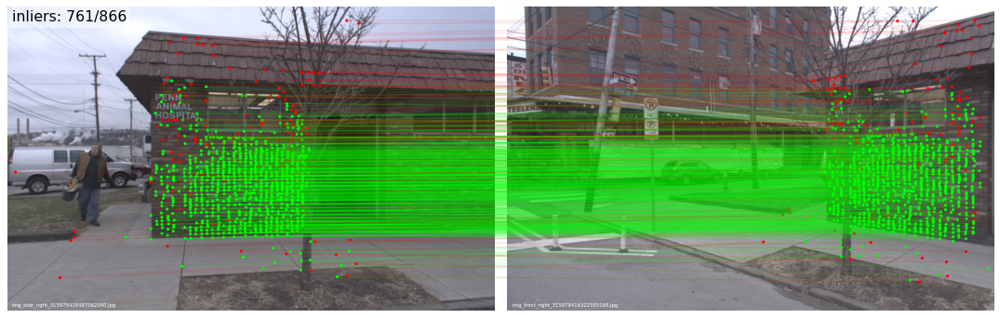

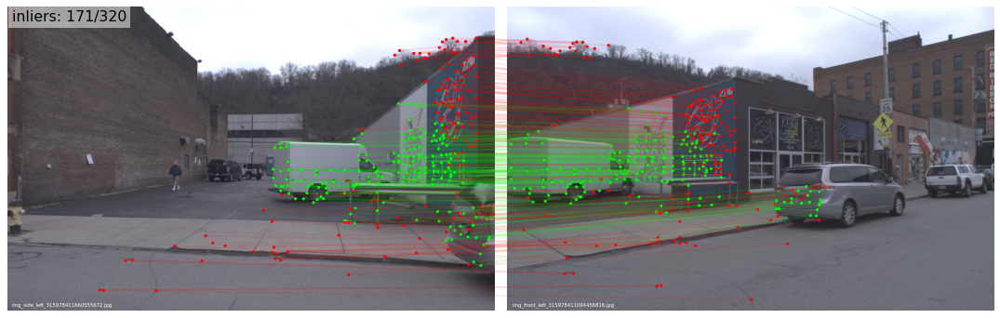

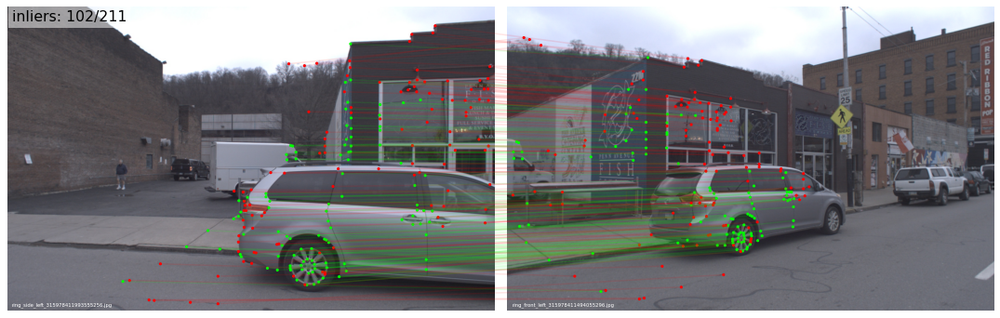

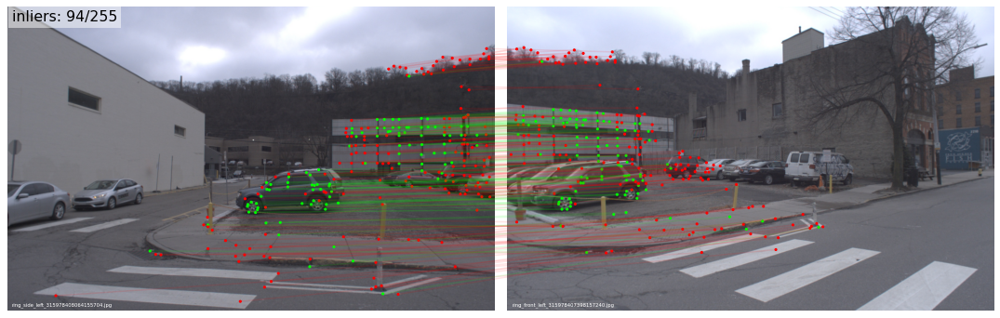

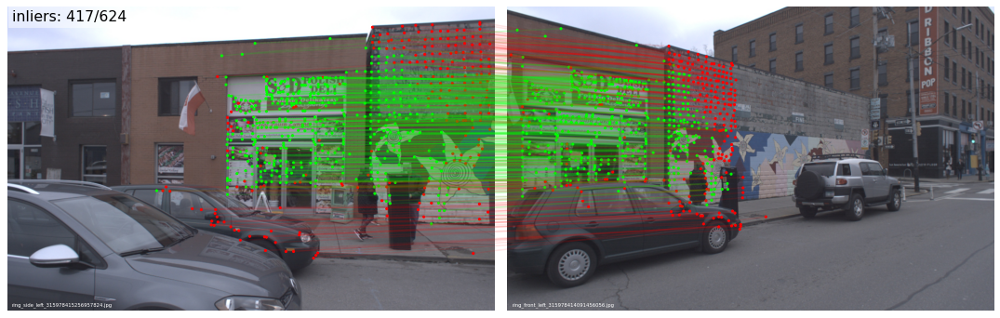

...

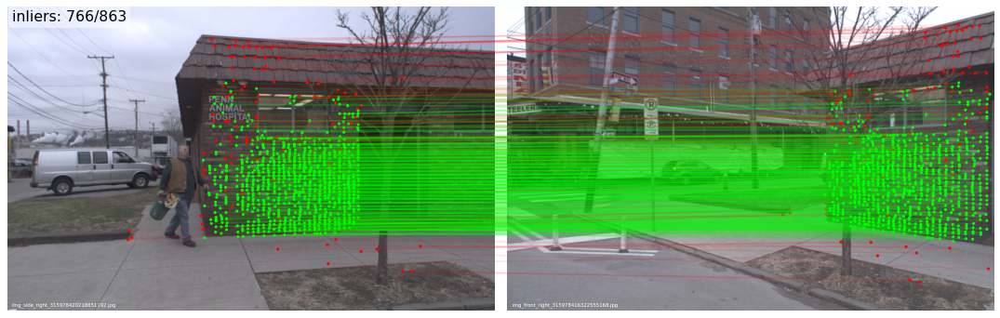

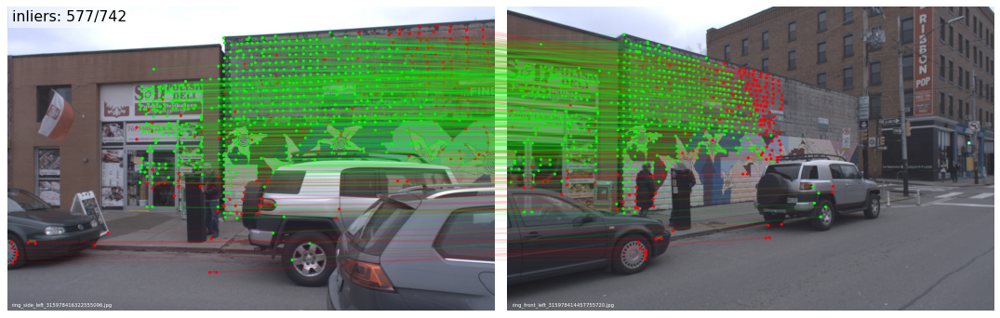

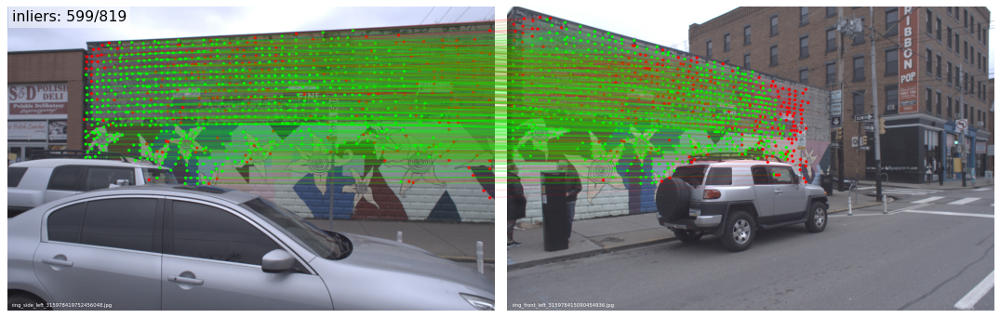

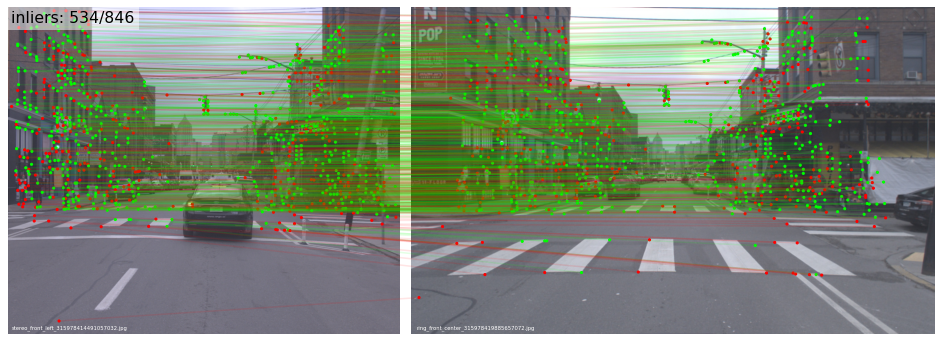

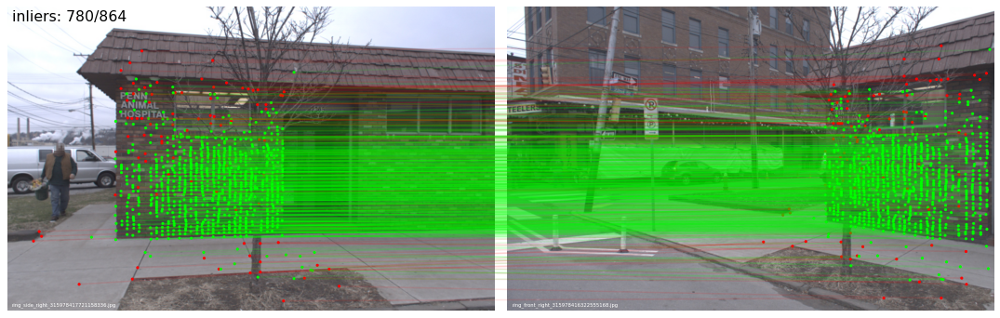

In [31]:
visualization.visualize_loc(
    results, images, sfm_dir / 'models/model_aligned/', n=40, top_k_db=1, prefix='', seed=6)

## Generate the Ground Truth Camera Position for db image
So that we could use COLMAP model_aligner to rescale the 3d model

In [34]:
import glob
import json
from tqdm import tqdm
from scipy.spatial.transform import Rotation
import numpy as np

calib_file_dir = '/home/cloudlet/datasets/argoverse-tracking/sample/c6911883-1843-3727-8eaa-41dc8cda8993/vehicle_calibration_info.json'
T_vc_front_left = {}
T_vc_front_right = {}
T_vc_front_center = {}
T_vc_rear_left = {}
T_vc_rear_right = {}
with open(calib_file_dir) as json_file: 
    calib = json.load(json_file) 
#     print(calib['camera_data_'])
    for item in calib['camera_data_']:
        if 'ring_front_left' in item['key']:
            pose =  item['value']['vehicle_SE3_camera_']
            T_vc_front_left = {'rotation': pose['rotation']['coefficients'],\
                               'translation': pose['translation']}

        if 'ring_front_right' in item['key']:
            pose =  item['value']['vehicle_SE3_camera_']
            T_vc_front_right = {'rotation': pose['rotation']['coefficients'],\
                               'translation': pose['translation']}
        if 'ring_front_center' in item['key']:
            pose =  item['value']['vehicle_SE3_camera_']
            T_vc_front_center = {'rotation': pose['rotation']['coefficients'],\
                               'translation': pose['translation']}

        if 'ring_rear_left' in item['key']:
            pose =  item['value']['vehicle_SE3_camera_']
            T_vc_rear_left = {'rotation': pose['rotation']['coefficients'],\
                               'translation': pose['translation']}
            
        if 'ring_rear_right' in item['key']:
            pose =  item['value']['vehicle_SE3_camera_']
            T_vc_rear_right = {'rotation': pose['rotation']['coefficients'],\
                               'translation': pose['translation']}
            
        if 'ring_side_left' in item['key']:
            pose =  item['value']['vehicle_SE3_camera_']
            T_vc_side_left = {'rotation': pose['rotation']['coefficients'],\
                               'translation': pose['translation']}

        if 'ring_side_right' in item['key']:
            pose =  item['value']['vehicle_SE3_camera_']
            T_vc_side_right = {'rotation': pose['rotation']['coefficients'],\
                               'translation': pose['translation']}
        
        if 'stereo_front_left' in item['key']:
            pose =  item['value']['vehicle_SE3_camera_']
            T_vc_stereo_front_left = {'rotation': pose['rotation']['coefficients'],\
                               'translation': pose['translation']}

        if 'stereo_front_right' in item['key']:
            pose =  item['value']['vehicle_SE3_camera_']
            T_vc_stereo_front_right = {'rotation': pose['rotation']['coefficients'],\
                               'translation': pose['translation']}
            
def tf_matrix(qvec, tvec):
    # suppose argoverse is [qw,qx,qy,qz], while scipy is [qx,qy,qz,qw]
    R = Rotation.from_quat([qvec[1], qvec[2], qvec[3], qvec[0]]).as_matrix()
    t = np.array(tvec).reshape(3,1)
    T = np.concatenate((R, t), axis=1)
    T = np.concatenate((T, np.array([[0,0,0,1]])), axis=0)
#     print(T)
    return T

def pos_from_Tcw(qvec, tvec):
    R = Rotation.from_quat([qvec[1], qvec[2], qvec[3], qvec[0]]).as_matrix()
    t = np.array(tvec).reshape(3,1)
    pos = -R.transpose() @ t
    return pos.reshape((3,))

def gt_position(img_name):
    ts = img_name.split('_')[-1]
    if 'side_left' in img_name:
        pose_vc = T_vc_side_left
    elif 'side_right' in img_name:
        pose_vc = T_vc_side_right
    elif 'rear_left' in img_name:
        pose_vc = T_vc_rear_left
    elif 'rear_right' in img_name:
        pose_vc = T_vc_rear_right
    elif 'stereo_front_left' in img_name:
        pose_vc = T_vc_stereo_front_left
    elif 'stereo_front_right' in img_name:
        pose_vc = T_vc_stereo_front_right
    else:
        print('error when reading pose_vc')
        
    if ts.endswith('.jpg'):
        ts = ts[:-4]
    else:
        print('wrong image name format')
    pose_dir = '/home/cloudlet/datasets/argoverse-tracking/sample/c6911883-1843-3727-8eaa-41dc8cda8993/poses/'
    with open(pose_dir + 'city_SE3_egovehicle_' + ts + '.json') as json_file: 
        pose_wv = json.load(json_file) # vehicle to world
        qvec = pose_wv['rotation']
        tvec = pose_wv['translation']
        T_wv = tf_matrix(qvec,tvec)
        T_vc = tf_matrix(pose_vc['rotation'], pose_vc['translation'])

        T_wc = T_wv @ T_vc
#         print(T_vc)
        pos = T_wc[:3, 3]
    return pos

3.5733380127416794
0.4104572041034701


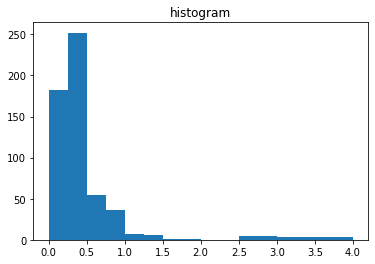

[182 252  55  36   7   6   1   1   0   5   3]


In [37]:
dist_list = []
with open(results, 'r') as poses_file:
    lines = poses_file.readlines()
    for line in lines:
        img_name = line.split(' ')[0]
        qvec = [float(q) for q in line.split(' ')[1:5]]
        tvec = [float(t) for t in line.split(' ')[5:]]
        pos = pos_from_Tcw(qvec, tvec) # camera position
        gt_pos = gt_position(img_name) # ground truth is vehicle position, also need to transfer to camera
#         print(img_name)
#         print(pos)
#         print(gt_pos)
        dist = np.linalg.norm(gt_pos-pos)
        dist_list.append(dist)
#         print(dist)
dist_np = np.array(dist_list)

print(np.max(dist_np))
print(np.average(dist_np))
# print(dist_np<2)

from matplotlib import pyplot as plt 
import numpy as np  

# plt.hist(dist_np, bins=[0,0.25,0.5,1,2,4,10], weights=counts) 
counts, bins = np.histogram(dist_np, bins=[0,0.25,0.5,0.75,1,1.25,1.5,1.75,2,2.5,3,4])
plt.hist(bins[:-1], bins, weights=counts)
plt.title("histogram") 
plt.show()
print(counts)